# Lab 07 - Object Detection

This lab uses the pretrained YOLOv8 models from ultralytics for different tasks.

## Download and Import Ultralytics

In [1]:
# install and import ulrtalytics
!uv pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.207 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.4/112.6 GB disk)


## Import neccessary packages

In [2]:
from ultralytics import YOLO
import time
import os
import matplotlib.pyplot as plt
from PIL import Image
import math

# 1. Detection tasks

For this detection task, I will load all the models from ultralytics (yolov8n.pt, yolov8s.pt, yolov8m.pt, yolov8l.pt, yolov8x.pt). Then I will use these models to detect objects in an image and compare the performance between them.

In [3]:
# Path to your image
image_path = "images/detection.jpg"

In [4]:
# List of YOLOv8 model weights to test
models = [
    "yolov8n.pt",  # nano
    "yolov8s.pt",  # small
    "yolov8m.pt",  # medium
    "yolov8l.pt",  # large
    "yolov8x.pt"   # extra large
]

In [5]:
# Create results directory
os.makedirs("results", exist_ok=True)

In [6]:
# Store results summary and image paths
results_summary = []
output_images = []

In [7]:
# Run detection for each model
for model_name in models:
    print(f"\nTesting {model_name}...")

    # Load model
    model = YOLO(model_name)

    # Inference and timing
    start_time = time.time()
    results = model(image_path, save=True, project="results", name=model_name.split('.')[0], exist_ok=True)
    end_time = time.time()

    # Count detections
    num_detections = len(results[0].boxes)
    detection_time = round(end_time - start_time, 3)

    # Get saved image path
    result_img_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))

    results_summary.append({
        "Model": model_name,
        "Detections": num_detections,
        "Inference Time (s)": detection_time,
        "Image Path": result_img_path
    })

    output_images.append(result_img_path)

    print(f"Done: {num_detections} objects detected in {detection_time:.3f} seconds.")
    print(f"Saved at: {result_img_path}")


Testing yolov8n.pt...

image 1/1 /content/images/detection.jpg: 384x640 7 persons, 1 bicycle, 1 car, 2 buss, 1 truck, 2 traffic lights, 68.9ms
Speed: 11.2ms preprocess, 68.9ms inference, 282.8ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/results/yolov8n
Done: 14 objects detected in 1.703 seconds.
Saved at: /content/results/yolov8n/detection.jpg

Testing yolov8s.pt...

image 1/1 /content/images/detection.jpg: 384x640 8 persons, 1 bicycle, 2 buss, 2 trucks, 1 traffic light, 34.2ms
Speed: 1.7ms preprocess, 34.2ms inference, 6.6ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/results/yolov8s
Done: 14 objects detected in 0.183 seconds.
Saved at: /content/results/yolov8s/detection.jpg

Testing yolov8m.pt...

image 1/1 /content/images/detection.jpg: 384x640 7 persons, 1 bicycle, 1 bus, 2 trucks, 2 traffic lights, 39.0ms
Speed: 1.7ms preprocess, 39.0ms inference, 6.3ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /

In [8]:
# --- Display results summary ---
print("\n--- YOLOv8 Model Performance Comparison ---")
for r in results_summary:
    print(f"{r['Model']:<10} | Detections: {r['Detections']:<3} | Inference Time: {r['Inference Time (s)']}s")


--- YOLOv8 Model Performance Comparison ---
yolov8n.pt | Detections: 14  | Inference Time: 1.703s
yolov8s.pt | Detections: 14  | Inference Time: 0.183s
yolov8m.pt | Detections: 13  | Inference Time: 0.307s
yolov8l.pt | Detections: 12  | Inference Time: 0.466s
yolov8x.pt | Detections: 14  | Inference Time: 0.792s


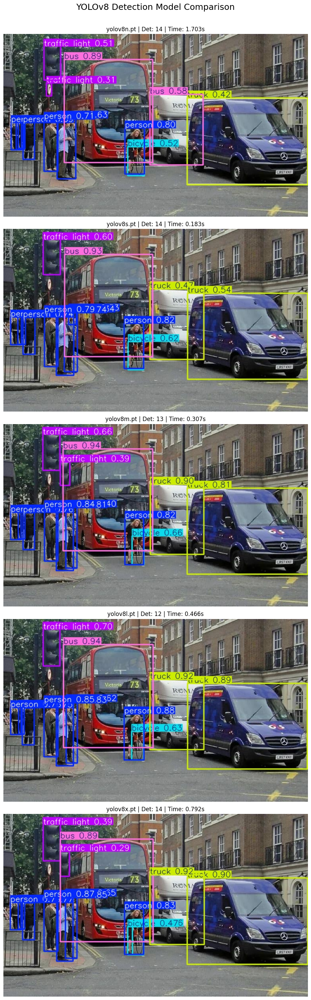

In [9]:
# Display the results
fig, axes = plt.subplots(5, 1, figsize=(10, 30))
fig.suptitle("YOLOv8 Detection Model Comparison", fontsize=18)

for ax, img_path, info in zip(axes, output_images, results_summary):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(
        f"{info['Model']} | Det: {info['Detections']} | Time: {info['Inference Time (s)']}s",
        fontsize=12
    )

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()

## 2. Segmentation Task

For this segmentation task, I will load all the models from ultralytics (yolov8n-seg.pt, yolov8s-seg.pt, yolov8m-seg.pt, yolov8l-seg.pt, yolov8x-seg.pt). Then I will use these models to segment objects in an image and compare the performance between them.

In [10]:
# Path to input image
image_path = "images/segmentation.jpg"

In [11]:
# List of YOLOv8 segmentation models
models = [
    "yolov8n-seg.pt",
    "yolov8s-seg.pt",
    "yolov8m-seg.pt",
    "yolov8l-seg.pt",
    "yolov8x-seg.pt"
]

In [12]:
# Array to store the results
results_summary = []
output_images = []

# Run inference for each model
for model_name in models:
    print(f"Running {model_name}...")

    # load the model
    model = YOLO(model_name)

    # Start timer
    start_time = time.time()

    # do the inference
    results = model(
        image_path,
        task="segment",
        save=True,
        project="results_seg",
        name=model_name.split('.')[0],
        exist_ok=True
    )

    # End timer
    end_time = time.time()

    # Number of objects being segmented
    num_segments = len(results[0].boxes) if hasattr(results[0], "boxes") and results[0].boxes is not None else 0

    # Calculate the inference time
    inference_time = round(end_time - start_time, 3)

    # Save the results
    result_img_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))
    output_images.append(result_img_path)

    results_summary.append({
        "Model": model_name,
        "Segments": num_segments,
        "Inference Time (s)": inference_time,
        "Image Path": result_img_path
    })

    print(f"{num_segments} objects segmented in {inference_time}s. Saved at {result_img_path}")

Running yolov8n-seg.pt...

image 1/1 /content/images/segmentation.jpg: 448x640 3 cats, 4 dogs, 58.6ms
Speed: 2.6ms preprocess, 58.6ms inference, 58.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/results_seg/yolov8n-seg
7 objects segmented in 0.232s. Saved at /content/results_seg/yolov8n-seg/segmentation.jpg
Running yolov8s-seg.pt...

image 1/1 /content/images/segmentation.jpg: 448x640 2 cats, 4 dogs, 42.2ms
Speed: 1.7ms preprocess, 42.2ms inference, 4.9ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/results_seg/yolov8s-seg
6 objects segmented in 0.172s. Saved at /content/results_seg/yolov8s-seg/segmentation.jpg
Running yolov8m-seg.pt...

image 1/1 /content/images/segmentation.jpg: 448x640 2 cats, 2 dogs, 52.9ms
Speed: 1.8ms preprocess, 52.9ms inference, 3.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/results_seg/yolov8m-seg
4 objects segmented in 0.327s. Saved at /content/results_seg/yolov8m-seg

In [13]:
# Display performance summary
print("\nSegmentation Performance Summary:")
for r in results_summary:
    print(f"{r['Model']:<15} | Segments: {r['Segments']:<3} | Time: {r['Inference Time (s)']}s")


Segmentation Performance Summary:
yolov8n-seg.pt  | Segments: 7   | Time: 0.232s
yolov8s-seg.pt  | Segments: 6   | Time: 0.172s
yolov8m-seg.pt  | Segments: 4   | Time: 0.327s
yolov8l-seg.pt  | Segments: 5   | Time: 0.476s
yolov8x-seg.pt  | Segments: 5   | Time: 0.813s


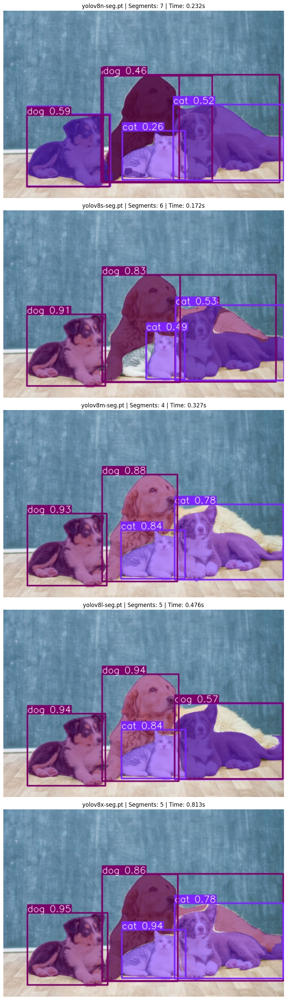

In [14]:
# Display segmentation results
fig, axes = plt.subplots(len(output_images), 1, figsize=(10, 30))
for ax, img_path, info in zip(axes, output_images, results_summary):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f"{info['Model']} | Segments: {info['Segments']} | Time: {info['Inference Time (s)']}s", fontsize=12)

plt.tight_layout()
plt.show()

## 3. Pose Task

For this pose detection task, I will load all the models from ultralytics (pose	yolov8n-pose.pt, yolov8s-pose.pt, yolov8m-pose.pt, yolov8l-pose.pt, yolov8x-pose.pt, yolov8x-pose-p6.pt). Then I will use these models to detect poses in an image and compare the performance between them.

In [15]:
# Path to input image
image_path = "images/pose.jpg"

In [16]:
# List of YOLOv8 pose models
models = [
    "yolov8n-pose.pt",
    "yolov8s-pose.pt",
    "yolov8m-pose.pt",
    "yolov8l-pose.pt",
    "yolov8x-pose.pt",
    "yolov8x-pose-p6.pt"
]

In [17]:
# Create results directory
os.makedirs("results_pose", exist_ok=True)

In [18]:
# Arrays to store the results
results_summary = []
output_images = []

# Run pose detection for each model
for model_name in models:
    print(f"Running {model_name}...")

    # Load the model
    model = YOLO(model_name)

    # Start timer
    start_time = time.time()

    # Running inference
    results = model(
        image_path,
        task="pose",
        save=True,
        project="results_pose",
        name=model_name.split('.')[0],
        exist_ok=True
    )

    # End timer
    end_time = time.time()

    # Calclate the number of poses
    num_poses = len(results[0].keypoints) if hasattr(results[0], "keypoints") and results[0].keypoints is not None else 0

    # Calculate the inference time
    inference_time = round(end_time - start_time, 3)

    # Save the results
    result_img_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))
    output_images.append(result_img_path)

    results_summary.append({
        "Model": model_name,
        "Poses": num_poses,
        "Inference Time (s)": inference_time,
        "Image Path": result_img_path
    })

    print(f"{num_poses} poses detected in {inference_time}s. Saved at {result_img_path}")

Running yolov8n-pose.pt...

image 1/1 /content/images/pose.jpg: 384x640 3 persons, 26.6ms
Speed: 3.0ms preprocess, 26.6ms inference, 3.8ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/results_pose/yolov8n-pose
3 poses detected in 0.197s. Saved at /content/results_pose/yolov8n-pose/pose.jpg
Running yolov8s-pose.pt...

image 1/1 /content/images/pose.jpg: 384x640 3 persons, 12.5ms
Speed: 1.8ms preprocess, 12.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/results_pose/yolov8s-pose
3 poses detected in 0.154s. Saved at /content/results_pose/yolov8s-pose/pose.jpg
Running yolov8m-pose.pt...

image 1/1 /content/images/pose.jpg: 384x640 3 persons, 27.2ms
Speed: 1.9ms preprocess, 27.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/results_pose/yolov8m-pose
3 poses detected in 0.307s. Saved at /content/results_pose/yolov8m-pose/pose.jpg
Running yolov8l-pose.pt...

image 1/1 /c

In [19]:
# Display performance summary
print("\nPose Detection Performance Summary:")
for r in results_summary:
    print(f"{r['Model']:<15} | Poses: {r['Poses']:<3} | Time: {r['Inference Time (s)']}s")


Pose Detection Performance Summary:
yolov8n-pose.pt | Poses: 3   | Time: 0.197s
yolov8s-pose.pt | Poses: 3   | Time: 0.154s
yolov8m-pose.pt | Poses: 3   | Time: 0.307s
yolov8l-pose.pt | Poses: 3   | Time: 0.477s
yolov8x-pose.pt | Poses: 3   | Time: 0.768s
yolov8x-pose-p6.pt | Poses: 3   | Time: 1.288s


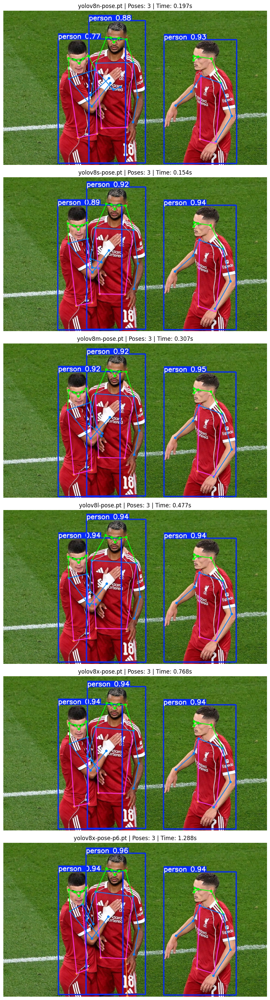

In [20]:
# Display pose detection results
fig, axes = plt.subplots(len(output_images), 1, figsize=(10, 30))
for ax, img_path, info in zip(axes, output_images, results_summary):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f"{info['Model']} | Poses: {info['Poses']} | Time: {info['Inference Time (s)']}s", fontsize=12)

plt.tight_layout()
plt.show()

## 4. OBB

For this detection task, I will load all the models from ultralytics (yolov8n-obb.pt, yolov8s-obb.pt, yolov8m-obb.pt, yolov8l-obb.pt, yolov8x-obb.pt). Then I will use these models to detect object in an image and compare the performance between them.

In [21]:
# Path to input image
image_path = "images/obb.jpg"

In [22]:
# List of YOLOv8 OBB models
models = [
    "yolov8n-obb.pt",
    "yolov8s-obb.pt",
    "yolov8m-obb.pt",
    "yolov8l-obb.pt",
    "yolov8x-obb.pt"
]

In [23]:
# Create results directory
os.makedirs("results_obb", exist_ok=True)

In [37]:
# Create arrays to store results
results_summary = []
output_images = []

# Run object detection for each model
for model_name in models:
    print(f"Running {model_name}...")

    # Load the model
    model = YOLO(model_name)

    # Start timer
    start_time = time.time()

    # Running inference
    results = model(
        image_path,
        task="detect",
        save=True,
        project="results_obb",
        name=model_name.split('.')[0],
        exist_ok=True
    )

    # End timer
    end_time = time.time()

    # Count the number of objects
    num_objects = len(results[0].boxes) if hasattr(results[0], "boxes") and results[0].boxes is not None else 0

    # Calculate the inference time
    inference_time = round(end_time - start_time, 3)

    # Store the results
    result_img_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))
    output_images.append(result_img_path)

    results_summary.append({
        "Model": model_name,
        "Objects": num_objects,
        "Inference Time (s)": inference_time,
        "Image Path": result_img_path
    })

    print(f"{num_objects} objects detected in {inference_time}s. Saved at {result_img_path}")

Running yolov8n-cls.pt...

image 1/1 /content/images/classification.jpg: 224x224 Persian_cat 0.84, Egyptian_cat 0.05, tabby 0.02, hamster 0.01, Pekinese 0.01, 4.4ms
Speed: 23.6ms preprocess, 4.4ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)
Results saved to /content/results_obb/yolov8n-cls
0 objects detected in 0.137s. Saved at /content/results_obb/yolov8n-cls/classification.jpg
Running yolov8s-cls.pt...

image 1/1 /content/images/classification.jpg: 224x224 Persian_cat 0.31, Egyptian_cat 0.11, tabby 0.11, Siamese_cat 0.10, bow_tie 0.03, 4.6ms
Speed: 19.1ms preprocess, 4.6ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)
Results saved to /content/results_obb/yolov8s-cls
0 objects detected in 0.205s. Saved at /content/results_obb/yolov8s-cls/classification.jpg
Running yolov8m-cls.pt...

image 1/1 /content/images/classification.jpg: 224x224 Persian_cat 0.35, Siamese_cat 0.12, tabby 0.07, feather_boa 0.05, hamster 0.04, 6.8ms
Speed: 17.1ms preprocess

In [25]:
# Display performance summary
print("\nOBB Detection Performance Summary:")
for r in results_summary:
    print(f"{r['Model']:<15} | Time: {r['Inference Time (s)']}s")



OBB Detection Performance Summary:
yolov8n-obb.pt  | Time: 0.473s
yolov8s-obb.pt  | Time: 0.329s
yolov8m-obb.pt  | Time: 0.475s
yolov8l-obb.pt  | Time: 0.686s
yolov8x-obb.pt  | Time: 0.988s


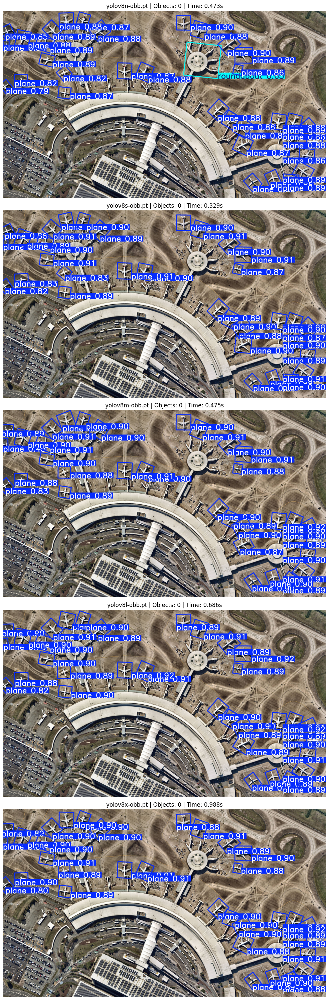

In [26]:
# Display OBB detection results
fig, axes = plt.subplots(len(output_images), 1, figsize=(10, 30))
for ax, img_path, info in zip(axes, output_images, results_summary):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f"{info['Model']} | Objects: {info['Objects']} | Time: {info['Inference Time (s)']}s", fontsize=12)

plt.tight_layout()
plt.show()


## 5. Classification

For this classification task, I will load all the models from ultralytics (yolov8n-cls.pt, yolov8s-cls.pt, yolov8m-cls.pt, yolov8l-cls.pt, yolov8x-cls.pt). Then I will use these models to classify object in an image and compare the performance between them.

In [27]:
# Path to input image
image_path = "images/classification.jpg"

In [28]:
# List of YOLOv8 classification models
models = [
    "yolov8n-cls.pt",
    "yolov8s-cls.pt",
    "yolov8m-cls.pt",
    "yolov8l-cls.pt",
    "yolov8x-cls.pt"
]

In [29]:
# Create results directory
os.makedirs("results_cls", exist_ok=True)

In [30]:
# Load the arrays for storing the results
results_summary = []
output_images = []


# Do inference for each model
for model_name in models:
    print(f"Running {model_name}...")

    # Load the model
    model = YOLO(model_name)


    # Start the timer
    start_time = time.time()

    # Running inference
    results = model(
        image_path,
        task="classify",
        save=True,
        project="results_cls",
        name=model_name.split('.')[0],
        exist_ok=True
    )

    # End timer
    end_time = time.time()

    # Get predicted class and confidence
    if hasattr(results[0], "probs") and results[0].probs is not None:
        class_idx = results[0].probs.top1
        predicted_class = results[0].names[class_idx]
        confidence = float(results[0].probs.top1conf)
    else:
        predicted_class = "Unknown"
        confidence = 0.0

    # Calculate the inference time
    inference_time = round(end_time - start_time, 3)

    # Store the results
    result_img_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))
    output_images.append(result_img_path)

    results_summary.append({
        "Model": model_name,
        "Class": predicted_class,
        "Confidence": confidence,
        "Inference Time (s)": inference_time,
        "Image Path": result_img_path
    })

    print(f"Predicted class: {predicted_class} (conf: {confidence:.2f}) in {inference_time}s. Saved at {result_img_path}")

Running yolov8n-cls.pt...

image 1/1 /content/images/classification.jpg: 224x224 Persian_cat 0.84, Egyptian_cat 0.05, tabby 0.02, hamster 0.01, Pekinese 0.01, 2.5ms
Speed: 21.8ms preprocess, 2.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Results saved to /content/results_cls/yolov8n-cls
Predicted class: Persian_cat (conf: 0.84) in 0.546s. Saved at /content/results_cls/yolov8n-cls/classification.jpg
Running yolov8s-cls.pt...

image 1/1 /content/images/classification.jpg: 224x224 Persian_cat 0.31, Egyptian_cat 0.11, tabby 0.11, Siamese_cat 0.10, bow_tie 0.03, 3.1ms
Speed: 11.3ms preprocess, 3.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Results saved to /content/results_cls/yolov8s-cls
Predicted class: Persian_cat (conf: 0.31) in 0.143s. Saved at /content/results_cls/yolov8s-cls/classification.jpg
Running yolov8m-cls.pt...

image 1/1 /content/images/classification.jpg: 224x224 Persian_cat 0.35, Siamese_cat 0.12, tabby 0.07, feather_boa 0.05

In [31]:
# Display performance summary
print("\nClassification Performance Summary:")
for r in results_summary:
    print(f"{r['Model']:<15} | Class: {r['Class']:<15} | Time: {r['Inference Time (s)']}s")


Classification Performance Summary:
yolov8n-cls.pt  | Class: Persian_cat     | Time: 0.546s
yolov8s-cls.pt  | Class: Persian_cat     | Time: 0.143s
yolov8m-cls.pt  | Class: Persian_cat     | Time: 0.308s
yolov8l-cls.pt  | Class: Persian_cat     | Time: 0.521s
yolov8x-cls.pt  | Class: Persian_cat     | Time: 0.945s


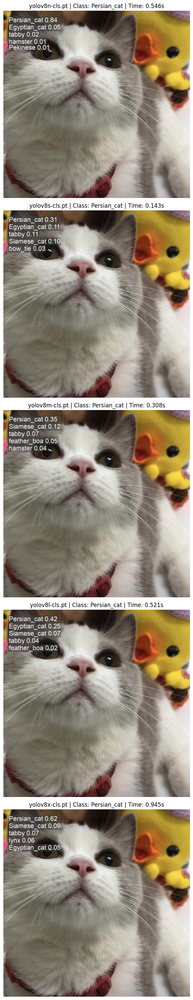

In [32]:
# Display classification results
fig, axes = plt.subplots(len(output_images), 1, figsize=(10, 30))
for ax, img_path, info in zip(axes, output_images, results_summary):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f"{info['Model']} | Class: {info['Class']} | Time: {info['Inference Time (s)']}s", fontsize=12)

plt.tight_layout()
plt.show()

## 6. Video Detection

For this video detection task, I will use the model to detect objects in a video.

In [33]:
# Path to input video
video_path = "videos/video.mp4"

In [34]:
# YOLOv8 model for detection
model_name = "yolov8x.pt"

In [35]:
# Create results directory
os.makedirs("results_video", exist_ok=True)

In [36]:
# Load model
model = YOLO(model_name)

# Run detection on video
start_time = time.time()
results = model(
    video_path,
    save=True,
    project="results_video",
    name=model_name.split('.')[0],
    exist_ok=True
)
end_time = time.time()

# Calculate inference time
inference_time = round(end_time - start_time, 3)

# Save the outputs
output_video_path = os.path.join(results[0].save_dir, os.path.basename(results[0].path))

print(f"Video processed in {inference_time}s. Saved at {output_video_path}")


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/151) /content/videos/video.mp4: 384x640 2 persons, 20 cars, 2 motorcycles, 2 trucks, 1 traffic light, 63.7ms
video 1/1 (frame 2/151) /content/videos/video.mp4: 384x640 2 persons, 20 cars, 2 motorcycles, 2 trucks, 2 traffic lights, 53.1ms
video 1/1 (frame 3/151) /content/videos/video.mp4: 384x640 2 persons, 20 cars, 2 motorcycles, 2 trucks, 1 traffic light, 53.2ms
video 1/1 (frame 4/151) /content/videos/video.mp4: 384x640 2 persons, 2